# Geospatial example

Rather than doing some of your work in Stata and some of your work in ArcGIS, you can do a lot of it in Python. The `geopandas` package is the geospatial version of the `pandas` package, and allows you do perform spatial operations, including drawing buffers, calculating distances, calculating areas, spatial joins, etc.

We'll do a quick example of merging our tabular data with geospatial. Often, we have a table of values we'd like to map. We need polygons attached to our geography, and then we want to quickly visualize. Our quick example will do a little bit of cleaning using `pandas`, merge on the polygon geometry, then plot the map (static and interactive map) using `geopandas` (static map) and `folium` (interactive map). 

Resources:
* [Folium docs](https://python-visualization.github.io/folium/modules.html)
* [Folium interactive choropleth map example](https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/GeoJsonPopupAndTooltip.ipynb
)
* [Folium different colormap examples](https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/Colormaps.ipynb)
* [Folium preset tile backgrounds](https://python-visualization.github.io/folium/quickstart.html)
* [Deal with white gap between Folium map and Jupyter Notebook cell](https://stackoverflow.com/questions/64792041/white-gap-between-python-folium-map-and-jupyter-notebook-cell)

In [1]:
import geopandas as gpd
import pandas as pd

# For map
import folium
from folium.features import GeoJsonPopup, GeoJsonTooltip
import branca.colormap
#import json
from branca.element import Figure

Quickly, we'll grab the CA county boundaries from CA Open Data Portal. 

https://gis.data.ca.gov/datasets/CALFIRE-Forestry::california-county-boundaries/data

Navigate to API > GeoJSON, and copy the URL.

In [2]:
URL = "https://opendata.arcgis.com/datasets/8713ced9b78a4abb97dc130a691a8695_0.geojson"
gdf = gpd.read_file(URL)

In [3]:
gdf.head(2)

,OBJECTID,COUNTY_NAME,COUNTY_ABBREV,COUNTY_NUM,COUNTY_CODE,COUNTY_FIPS,ISLAND,GlobalID,SHAPE_Length,SHAPE_Area,geometry
0,1,Alameda,ALA,1,01,001,None,{E6F92268-D2DD-4CFB-8B79-5B4B2F07C559},2.538264,0.217411,"MULTIPOLYGON (((-122.27125 37.90503, -122.2702..."
1,2,Alpine,ALP,2,02,003,None,{870479B2-480A-494B-8352-AD60578839C1},2.170420,0.198471,"MULTIPOLYGON (((-119.58667 38.71420, -119.5865..."


In [4]:
# Check what the CRS (coordinate reference system) is.
gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [5]:
gdf[["geometry"]].head()

,geometry
0,"MULTIPOLYGON (((-122.27125 37.90503, -122.2702..."
1,"MULTIPOLYGON (((-119.58667 38.71420, -119.5865..."
2,"MULTIPOLYGON (((-120.07246 38.70276, -120.0724..."
3,"MULTIPOLYGON (((-121.07661 39.59729, -121.0794..."
4,"MULTIPOLYGON (((-120.01792 38.43586, -120.0178..."


In [6]:
# To project to different CRS
# EPSG:2229 is CA state plane, and its units are feet. 
# You'd choose this one if you needed to work with distances (buffers, etc)
gdf = gdf.to_crs("EPSG:2229")
gdf[["geometry"]].head()

,geometry
0,"MULTIPOLYGON (((5327843.636 3270649.517, 53281..."
1,"MULTIPOLYGON (((6107872.113 3543254.346, 61079..."
2,"MULTIPOLYGON (((5968863.196 3541606.326, 59687..."
3,"MULTIPOLYGON (((5691714.322 3875581.366, 56907..."
4,"MULTIPOLYGON (((5982508.552 3443893.703, 59825..."


In [7]:
# Looks like there are duplicates
gdf.COUNTY_NAME.value_counts()

Santa Barbara      6
Ventura            5
Los Angeles        3
Riverside          1
Butte              1
Marin              1
Modoc              1
Tehama             1
Placer             1
San Bernardino     1
Inyo               1
San Joaquin        1
Monterey           1
San Diego          1
Shasta             1
Mono               1
Imperial           1
Lake               1
Amador             1
Merced             1
Kings              1
Colusa             1
San Mateo          1
Siskiyou           1
Sonoma             1
Yuba               1
San Benito         1
Yolo               1
Stanislaus         1
Tulare             1
Trinity            1
Humboldt           1
Santa Cruz         1
Fresno             1
Alameda            1
Lassen             1
Mendocino          1
Santa Clara        1
El Dorado          1
San Luis Obispo    1
Solano             1
Orange             1
Calaveras          1
Sierra             1
Kern               1
Sutter             1
Mariposa           1
Nevada       

<AxesSubplot:>

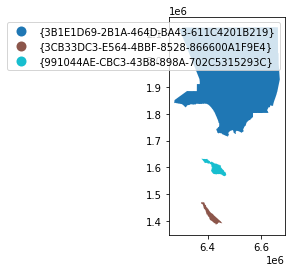

In [8]:
# Duplicates come from different GlobalID
gdf[gdf.COUNTY_NAME=="Los Angeles"].plot(column = "GlobalID", legend=True)

In [9]:
# Instead of dropping it, let's do a dissolve
gdf = gdf.dissolve(by="COUNTY_NAME").reset_index()
gdf.head()

,COUNTY_NAME,geometry,OBJECTID,COUNTY_ABBREV,COUNTY_NUM,COUNTY_CODE,COUNTY_FIPS,ISLAND,GlobalID,SHAPE_Length,SHAPE_Area
0,Alameda,"POLYGON ((5327843.636 3270649.517, 5328125.534...",1,ALA,1,01,001,None,{E6F92268-D2DD-4CFB-8B79-5B4B2F07C559},2.538264,0.217411
1,Alpine,"POLYGON ((6107872.113 3543254.346, 6107910.593...",2,ALP,2,02,003,None,{870479B2-480A-494B-8352-AD60578839C1},2.170420,0.198471
2,Amador,"POLYGON ((5968863.196 3541606.326, 5968719.695...",3,AMA,3,03,005,None,{4F45B3A6-BE10-461C-8945-6B2AAA7119F6},2.924268,0.161961
3,Butte,"POLYGON ((5691714.322 3875581.366, 5690777.192...",4,BUT,4,04,007,None,{44FBA680-AECC-4E04-A499-29D69AFFBD4A},4.210365,0.455899
4,Calaveras,"POLYGON ((5982508.552 3443893.703, 5982516.557...",5,CAL,5,05,009,None,{D11EF739-4A1E-414E-BFD1-E7DCD56CD61E},2.989673,0.275908


In [10]:
# Let's get a new column that is county fips code
gdf = (gdf.assign(
        fips = "06" + gdf.COUNTY_FIPS
    )[["COUNTY_NAME", "COUNTY_FIPS", "geometry", "fips"]]
)

gdf.head(2)

,COUNTY_NAME,COUNTY_FIPS,geometry,fips
0,Alameda,001,"POLYGON ((5327843.636 3270649.517, 5328125.534...",06001
1,Alpine,003,"POLYGON ((6107872.113 3543254.346, 6107910.593...",06003


## Merging
* When you're merging 2 dataframes, it matters less what you choose as left_df or right_df. 
    * You have to consider, if you want a left join, you'll keep all the observations from the left_df, regardless if it finds a match in the right_df. 
    * An inner join will only keep observations that are in both the left_df and right_df.
* When you're merging 1 geodataframe and 1 dataframe, your new df will take on the type of your left_df. 
    * If your left_df is a geodataframe, your merged df will be a geodataframe. 
    * If your left_df is a dataframe and right_df is a geodataframe, your merged df will be a dataframe. 

In [11]:
df = pd.read_parquet("../data/us-county-time-series.parquet")
df.head(2)

,county,state,fips,date,Lat,Lon,cases,deaths,incident_rate,people_tested,state_cases,state_deaths,new_cases,new_deaths,new_state_cases,new_state_deaths
62,Autauga,Alabama,01001,2020-03-24 07:00:00+00:00,32.539527,-86.644082,1,0,1.789901,<NA>,298,0,1,0,74,0
63,Autauga,Alabama,01001,2020-03-25 07:00:00+00:00,32.539527,-86.644082,5,0,8.949507,<NA>,472,1,4,0,174,1


In [12]:
# Merge our tabular data with geospatial data, so we can map it
# Note how we put our gdf as the left_df, because we want our merged df to be a geodataframe
gdf2 = pd.merge(gdf, df, 
                on = "fips", 
                how = "inner", 
                validate = "1:m" )

In [13]:
type(gdf2)

geopandas.geodataframe.GeoDataFrame

In [14]:
gdf2.head(2)

,COUNTY_NAME,COUNTY_FIPS,geometry,fips,county,state,date,Lat,Lon,cases,deaths,incident_rate,people_tested,state_cases,state_deaths,new_cases,new_deaths,new_state_cases,new_state_deaths
0,Alameda,001,"POLYGON ((5327843.636 3270649.517, 5328125.534...",06001,Alameda,California,2020-03-03 08:00:00+00:00,37.646294,-121.892927,1,0,0.059833,<NA>,25,0,1,0,4,0
1,Alameda,001,"POLYGON ((5327843.636 3270649.517, 5328125.534...",06001,Alameda,California,2020-03-04 08:00:00+00:00,37.646294,-121.892927,1,0,0.059833,<NA>,35,1,0,0,10,1


In [15]:
# Alternatively, we switch it to be a m:1 merge (note the change!)
# Even though we have our geometry column still, we still have a dataframe, not a geodataframe as a result
gdf3 = pd.merge(df, gdf, 
                on = "fips", 
                how = "inner", 
                validate = "m:1")

In [16]:
type(gdf3)

pandas.core.frame.DataFrame

In [17]:
gdf3.head(2)

,county,state,fips,date,Lat,Lon,cases,deaths,incident_rate,people_tested,state_cases,state_deaths,new_cases,new_deaths,new_state_cases,new_state_deaths,COUNTY_NAME,COUNTY_FIPS,geometry
0,Alameda,California,06001,2020-03-03 08:00:00+00:00,37.646294,-121.892927,1,0,0.059833,<NA>,25,0,1,0,4,0,Alameda,001,"POLYGON ((5327843.636 3270649.517, 5328125.534..."
1,Alameda,California,06001,2020-03-04 08:00:00+00:00,37.646294,-121.892927,1,0,0.059833,<NA>,35,1,0,0,10,1,Alameda,001,"POLYGON ((5327843.636 3270649.517, 5328125.534..."


In [18]:
# We would need an extra step of changing our dataframe into a geodataframe, and setting the CRS
gdf3 = gpd.GeoDataFrame(gdf3, crs="EPSG:2229")

In [19]:
type(gdf3)

geopandas.geodataframe.GeoDataFrame

## Plot a map

In [20]:
to_plot = (gdf2.sort_values(["fips", "date"], ascending=[True, False])
           .drop_duplicates(subset = ["fips"], keep="first")
           .reset_index(drop=True)
           .assign(
               # There is a data type called Int64, which allows for nullable integers.
               # But this data type isn't supported in geopandas for our plotting.
               cases = gdf2.cases.astype(int),
               deaths = gdf2.deaths.astype(int),
           )
          )

In [21]:
to_plot.head(2)

,COUNTY_NAME,COUNTY_FIPS,geometry,fips,county,state,date,Lat,Lon,cases,deaths,incident_rate,people_tested,state_cases,state_deaths,new_cases,new_deaths,new_state_cases,new_state_deaths
0,Alameda,001,"POLYGON ((5327843.636 3270649.517, 5328125.534...",06001,Alameda,California,2021-02-23 08:00:00+00:00,37.646294,-121.892927,1,0,4765.608686,<NA>,3536946,49541,0,0,0,0
1,Alpine,003,"POLYGON ((6107872.113 3543254.346, 6107910.593...",06003,Alpine,California,2021-02-23 08:00:00+00:00,38.596786,-119.822359,1,0,7085.916740,<NA>,3536946,49541,0,0,0,0


<AxesSubplot:>

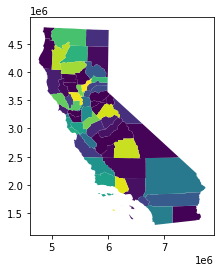

In [22]:
# geopandas comes with some basic plotting ability
to_plot.plot(column = "cases")

<AxesSubplot:>

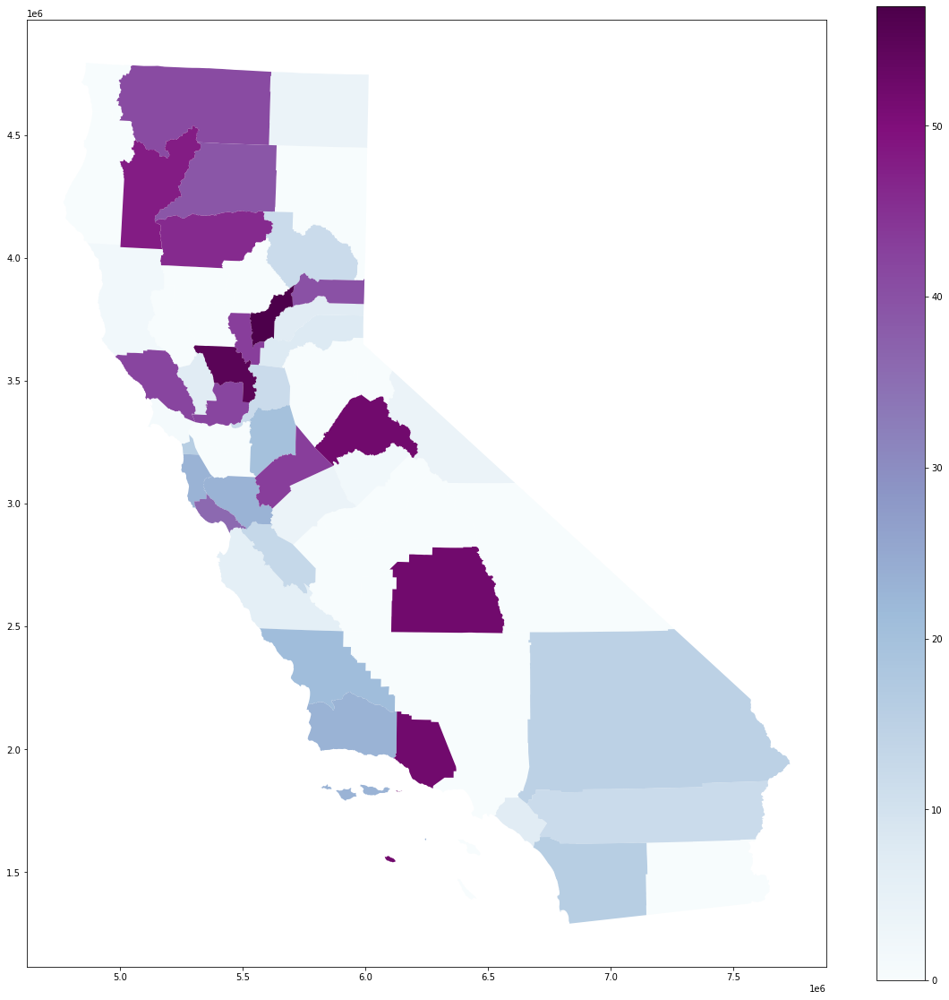

In [23]:
# Let's customize a litle bit, such as figure size, adding a legend, changing the colormap
to_plot.plot(column = "deaths", figsize=(20, 20), legend=True, cmap="BuPu")

In [24]:
# https://stackoverflow.com/questions/64792041/white-gap-between-python-folium-map-and-jupyter-notebook-cell
# Folium examples: https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/Colormaps.ipynb
fig = Figure(width=550, height=400)

max_scale = to_plot.cases.max()
colorscale = branca.colormap.linear.RdPu_09.to_step(6).scale(1, max_scale)                       


#https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/GeoJsonPopupAndTooltip.ipynb
m = folium.Map(location=[36.2, -119.1], tiles='cartodbpositron', 
               zoom_start=5.25, width=550,height=400)

# Other tiles instead of cartodbpositron:
# https://python-visualization.github.io/folium/quickstart.html

popup = GeoJsonPopup(
    fields=["county", "incident_rate"],
    aliases=["County", "Incident Rate"],
    localize=True,
    labels=True,
    style=f"background-color: lightgray;",
    max_width = 100,
)

tooltip = GeoJsonTooltip(
    fields=["county", 
            "new_cases",
            "new_deaths", 
            "cases", 
            "deaths",
           ],
    aliases=["County:", 
             "New Cases Yesterday:",
             "New Deaths Yesterday:", 
             "Cumulative Cases", 
             "Cumulative Deaths",
            ],
    localize=True,
    sticky=False,
    labels=True,
    style=f"""
        background-color: "lightgray";
        border: 0px #FFFFFF;
        border-radius: 0px;
        box-shadow: 0px;
        font-size: 11px;
    """,
    max_width=250,
)

#https://medium.com/analytics-vidhya/create-and-visualize-choropleth-map-with-folium-269d3fd12fa0
g = folium.GeoJson(
    to_plot.drop(columns = ["date"]),
    style_function=lambda x: {
        "fillColor": colorscale(x["properties"]["cases"])
        if x["properties"]["cases"] is not None
        else f"lightgray",
        "color": "#FFFFFF",
        "fillOpacity": 0.8,
        "weight": 0.2,
    },
    tooltip=tooltip,
    popup=popup,
).add_to(m)


fig.add_child(m)
fig